## Quiz #0701

### "TensorFlow machine learning with Calilfornia housing data"

In [188]:
import numpy as np
import pandas as pd
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
import matplotlib.pyplot as plt
import tensorflow.compat.v1 as tf
import warnings
import seaborn as sns
%matplotlib inline
warnings.filterwarnings('ignore')
tf.compat.v1.disable_eager_execution()    # Turn the warnings off.


#### Answer the following question by providing Python code:

In [189]:
# Bring the data.
housing_data = fetch_california_housing()

In [190]:
# Read the description.
print(housing_data['DESCR'])

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block
        - HouseAge      median house age in block
        - AveRooms      average number of rooms
        - AveBedrms     average number of bedrooms
        - Population    block population
        - AveOccup      average house occupancy
        - Latitude      house block latitude
        - Longitude     house block longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
http://lib.stat.cmu.edu/datasets/

The target variable is the median house value for California districts.

This dataset was derived from the 1990 U.S. census, using one row per census
block group. A block group is the smallest geographical unit for which the U.S.
Census Bur

1). Explore the data:
- Display the dataset as a DataFrame with column labels.

In [191]:
housing_data

{'data': array([[   8.3252    ,   41.        ,    6.98412698, ...,    2.55555556,
           37.88      , -122.23      ],
        [   8.3014    ,   21.        ,    6.23813708, ...,    2.10984183,
           37.86      , -122.22      ],
        [   7.2574    ,   52.        ,    8.28813559, ...,    2.80225989,
           37.85      , -122.24      ],
        ...,
        [   1.7       ,   17.        ,    5.20554273, ...,    2.3256351 ,
           39.43      , -121.22      ],
        [   1.8672    ,   18.        ,    5.32951289, ...,    2.12320917,
           39.43      , -121.32      ],
        [   2.3886    ,   16.        ,    5.25471698, ...,    2.61698113,
           39.37      , -121.24      ]]),
 'target': array([4.526, 3.585, 3.521, ..., 0.923, 0.847, 0.894]),
 'frame': None,
 'target_names': ['MedHouseVal'],
 'feature_names': ['MedInc',
  'HouseAge',
  'AveRooms',
  'AveBedrms',
  'Population',
  'AveOccup',
  'Latitude',
  'Longitude'],
 'DESCR': '.. _california_housing_dataset:\n

In [192]:
housing_data_ = pd.DataFrame((housing_data['data']))
housing_data_.columns = housing_data['feature_names']
housing_data_['MedHouseVal'] = housing_data['target']


In [193]:
housing_data_


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422
...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847


In [194]:
housing_data__=scale(housing_data_)

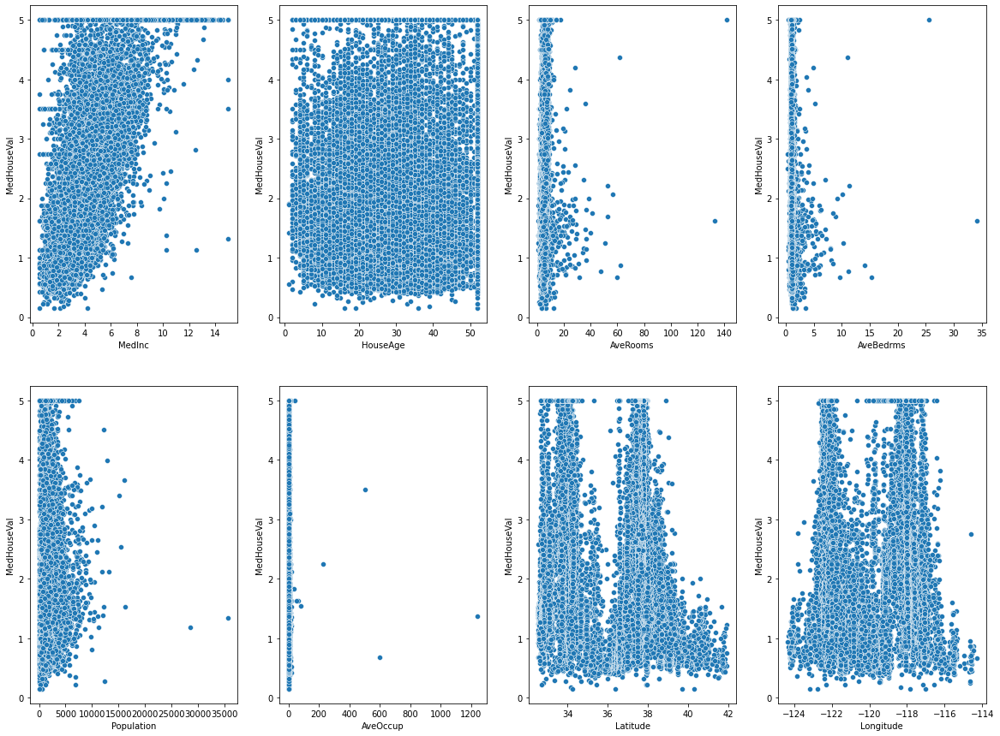

In [195]:
i = 1
plt.figure(figsize=(20, 15))
for m in list(housing_data_.columns)[:-1]:
    plt.subplot(2, 4, i)
    sns.scatterplot(housing_data_[m], housing_data_['MedHouseVal'])
    i += 1




In [196]:
housing_data_['AveOccup'].describe()


count    20640.000000
mean         3.070655
std         10.386050
min          0.692308
25%          2.429741
50%          2.818116
75%          3.282261
max       1243.333333
Name: AveOccup, dtype: float64

In [197]:
housing_data_['MedInc'] = np.where(
    housing_data_['MedInc'] > housing_data_['MedInc'].mean()+3*housing_data_['MedInc'].std(), housing_data_['MedInc'].median(), housing_data_['MedInc'])


In [198]:
housing_data_['MedInc'].describe()


count    20640.000000
mean         3.735332
std          1.591663
min          0.499900
25%          2.563400
50%          3.534750
75%          4.643700
max          9.556100
Name: MedInc, dtype: float64

2). Build a machine learning model with TensorFlow. 
- Preprocess the data if necessary.
- Build a linear regression model.
- Train the model.
- Calculate the error metrics such as MSE and RMSE (in-sample and out-of-sample). Target: RMSE < 1.

### PREPROCESSIG

In [199]:
x = housing_data_['MedInc']
y = housing_data.target

x.shape , y.shape


((20640,), (20640,))

In [200]:
x_train,x_test, y_train, y_test = train_test_split(
    x, y, test_size=0.2, random_state=1234)


### LINEAR REGRESSION MODEL

In [201]:
# Initial value of the weights = 1.

W = tf.Variable(1.0)
b=tf.Variable(1.0)


In [202]:
x_ph = tf.placeholder(tf.float32, shape=(None))
y_ph = tf.placeholder(tf.float32, shape=(None))


In [203]:
y_model =x_ph* W + b


In [204]:
loss = tf.reduce_mean(tf.square(y_ph - y_model))
optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)


### TRAIN THE MODEL

In [206]:
n_epochs = 1000

train = optimizer.minimize(loss)

init = tf.global_variables_initializer()



with tf.compat.v1.Session() as sess:

    init.run()
    # Training.
    my_feed = {x_ph: x, y_ph: y}

    for i in range(n_epochs):
        sess.run(train, feed_dict=my_feed)
        # final values of the Variables.
    w_model, b_model = sess.run([W,b])
        # Testing.

        # Calculate the in-sample MSE.
    mse_value = sess.run(loss, feed_dict=my_feed)

print("MSE  = {:5.3f}".format(mse_value))
print("RMSE = {:5.3f}".format(np.sqrt(mse_value)))


MSE  = 0.840
RMSE = 0.917


### MSE / RMSE